## Augmentation functions of color group
#### **[overview](https://imgaug.readthedocs.io/en/latest/source/overview/color.html)** **[docs](https://imgaug.readthedocs.io/en/latest/source/api_augmenters_color.html)**

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import imgaug as ia
from imgaug import augmenters as iaa
from imgaug import parameters as iap

In [3]:
image = ia.quokka(size=(1024, 1024), extract="square")

In [4]:
def print_aug(aug, n=16):
    # Augment images and segmaps.
    images_aug = []

    for _ in range(n):
        images_aug_i = aug(image=image)
        images_aug.append(images_aug_i)

    cells = []
    for image_aug in images_aug:
        cells.append(image_aug)                                      

    # Convert cells to a grid image and save.
    result_grid_image = ia.draw_grid(cells, cols=8)

    # plot functions 
    # note that the last image is augmented by matplotlib to make classes distingushable

    plt.figure()
    f, window = plt.subplots(1,1,figsize=(40,20)) 
    window.imshow(result_grid_image)
    window.axis('off')

4.78 ms ± 77.7 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


<Figure size 432x288 with 0 Axes>

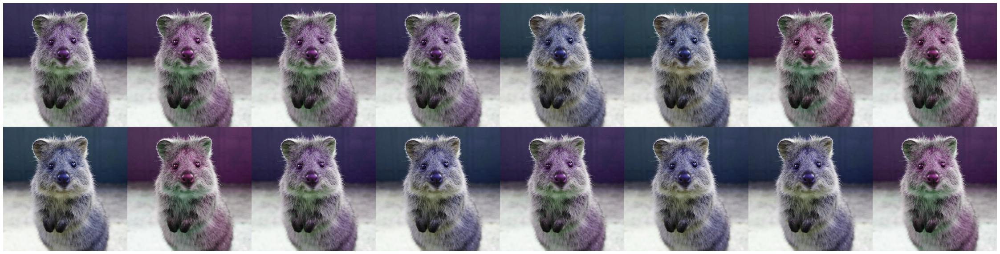

In [5]:
aug = iaa.WithColorspace(
    to_colorspace="HSV",
    from_colorspace="RGB",
    children=iaa.WithChannels(
        0,
        iaa.Add((0, 50))
    )
)
%timeit test = aug(image=image)
print_aug(aug)

5.17 ms ± 232 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


<Figure size 432x288 with 0 Axes>

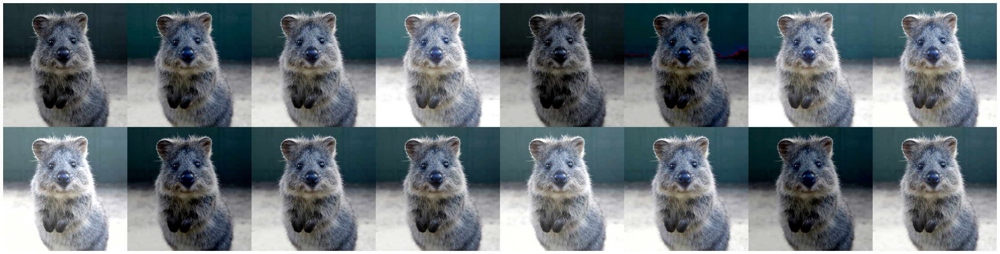

In [6]:
aug = iaa.WithBrightnessChannels(iaa.Add((-50, 50)))
%timeit test = aug(image=image)
print_aug(aug)

25.9 ms ± 1.48 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


<Figure size 432x288 with 0 Axes>

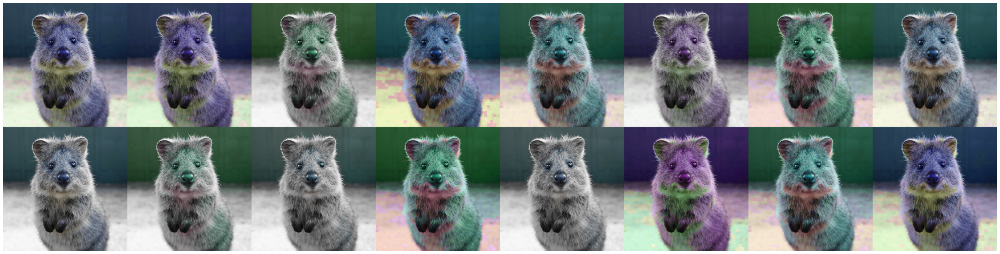

In [12]:
#NOTE: WithChannels() is a meta augmentor that can be used for apllay augmentations (es Add()) to specific channel of image, if passed into               WithHueAndSaturation, wh can chose beetwen 2 channels Hue and Saturation and not rgb in this context.

aug = iaa.WithHueAndSaturation([
        iaa.WithChannels(0, iaa.Add((-50, 50))),
        iaa.WithChannels(1, iaa.Add((-50, 50)))
    ]
)
%timeit test = aug(image=image)
print_aug(aug)

25.7 ms ± 1.31 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


<Figure size 432x288 with 0 Axes>

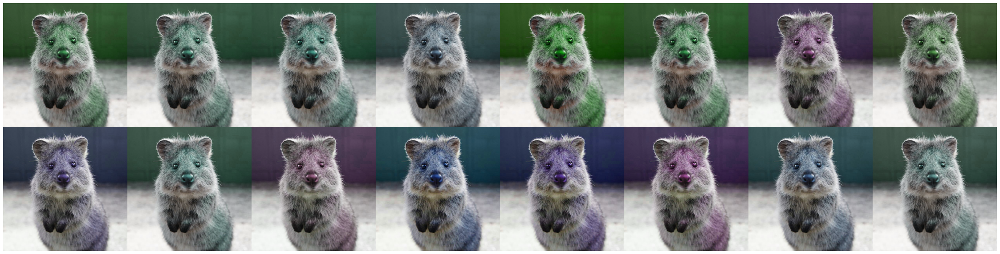

In [13]:
aug = iaa.MultiplyHueAndSaturation((0.5, 1.5), per_channel=True)
%timeit test = aug(image=image)
print_aug(aug)

21.9 ms ± 977 µs per loop (mean ± std. dev. of 7 runs, 10 loops each)


<Figure size 432x288 with 0 Axes>

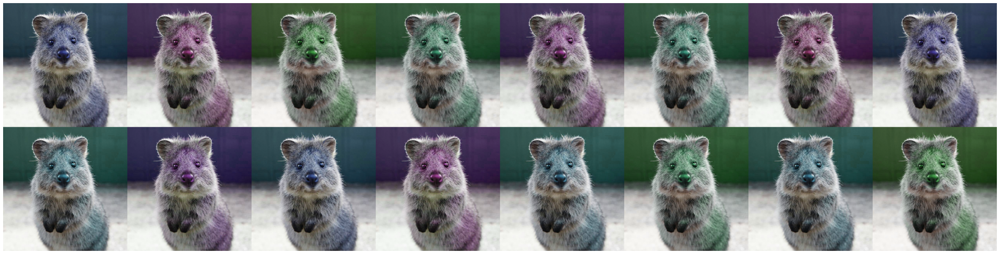

In [14]:
aug = iaa.MultiplyHue((0.5, 1.5))
%timeit test = aug(image=image)
print_aug(aug)

21.7 ms ± 1.39 ms per loop (mean ± std. dev. of 7 runs, 10 loops each)


<Figure size 432x288 with 0 Axes>

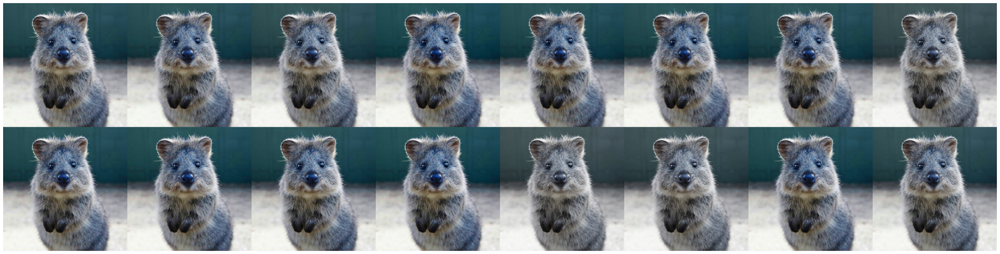

In [15]:
aug = iaa.MultiplySaturation((0.5, 1.5))
%timeit test = aug(image=image)
print_aug(aug)

12.2 ms ± 194 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


<Figure size 432x288 with 0 Axes>

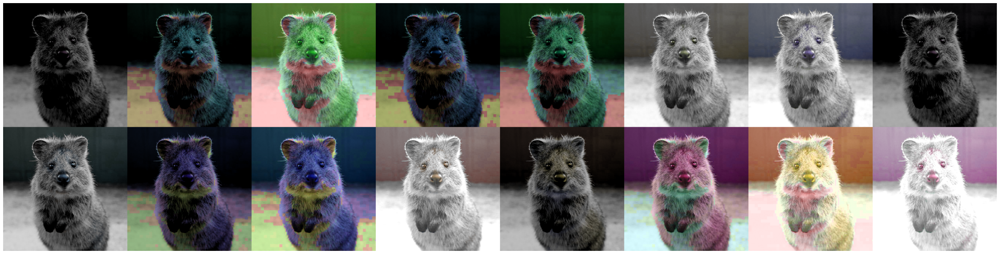

In [22]:
aug = iaa.Sequential([
    iaa.ChangeColorspace(from_colorspace="RGB", to_colorspace="HSV"),
    iaa.WithChannels(0, iaa.Add((-100, 100))),
    iaa.WithChannels(1, iaa.Add((-100, 100))),
    iaa.WithChannels(2, iaa.Add((-100, 100))),
    iaa.ChangeColorspace(from_colorspace="HSV", to_colorspace="RGB")
])
%timeit test = aug(image=image)
print_aug(aug)

11.5 ms ± 448 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


<Figure size 432x288 with 0 Axes>

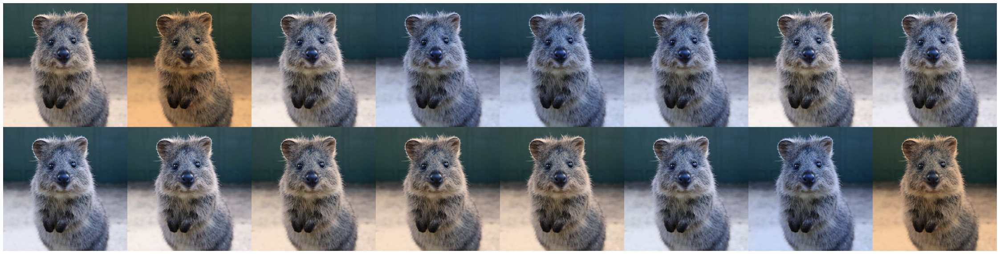

In [23]:
aug = iaa.ChangeColorTemperature((1100, 10000))
%timeit test = aug(image=image)
print_aug(aug)

7.7 ms ± 139 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


<Figure size 432x288 with 0 Axes>

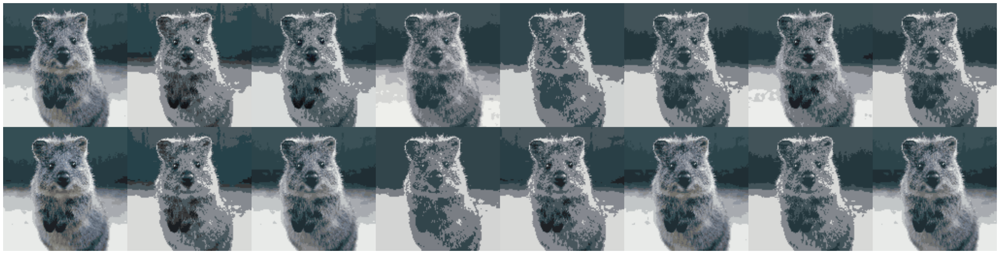

In [24]:
aug = iaa.KMeansColorQuantization()
%timeit test = aug(image=image)
print_aug(aug)

2.72 ms ± 98.9 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


<Figure size 432x288 with 0 Axes>

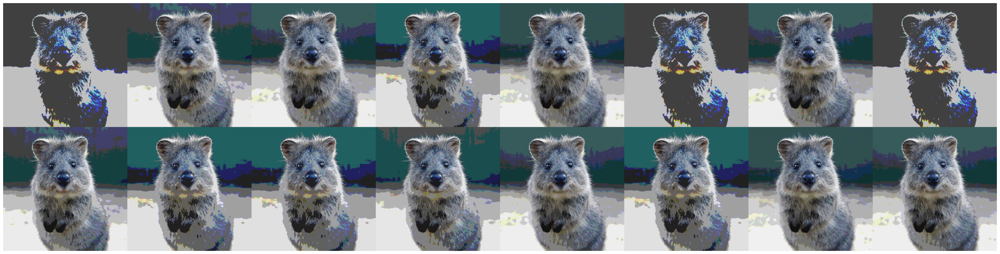

In [26]:
aug = iaa.UniformColorQuantization(n_colors=(2, 8))
%timeit test = aug(image=image)
print_aug(aug)

2.75 ms ± 85.1 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


<Figure size 432x288 with 0 Axes>

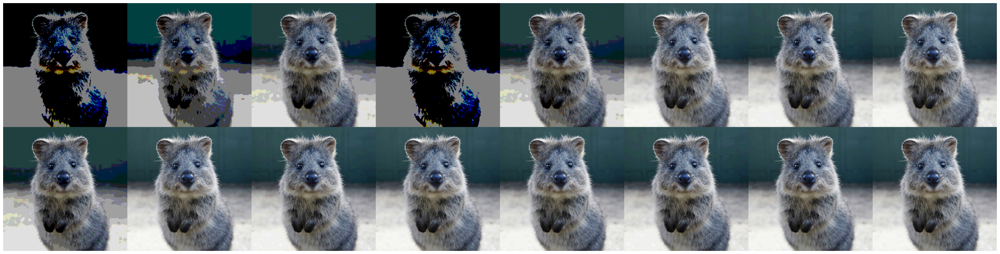

In [27]:
aug = iaa.Posterize()
%timeit test = aug(image=image)
print_aug(aug)